In [1]:
import pandas as pd
import numpy as np
from src.utils.utils import load_forecaster
import src.utils.constants as constants
import src.models.price_optimisation as price_optimisation
import matplotlib.pyplot as plt
import os

In [2]:
os.environ['GRB_LICENSE_FILE'] = './gurobi.lic'

In [3]:
# Load previously saved forecaster object 
forecaster = load_forecaster(constants.MODEL_DIR / "subcat_by_week_demand_forecaster.pkl")

In [4]:
base_prices = (
    forecaster.df_panel
    .groupby('subcategory_identifier')['price']
    .median()
    .to_dict()
)

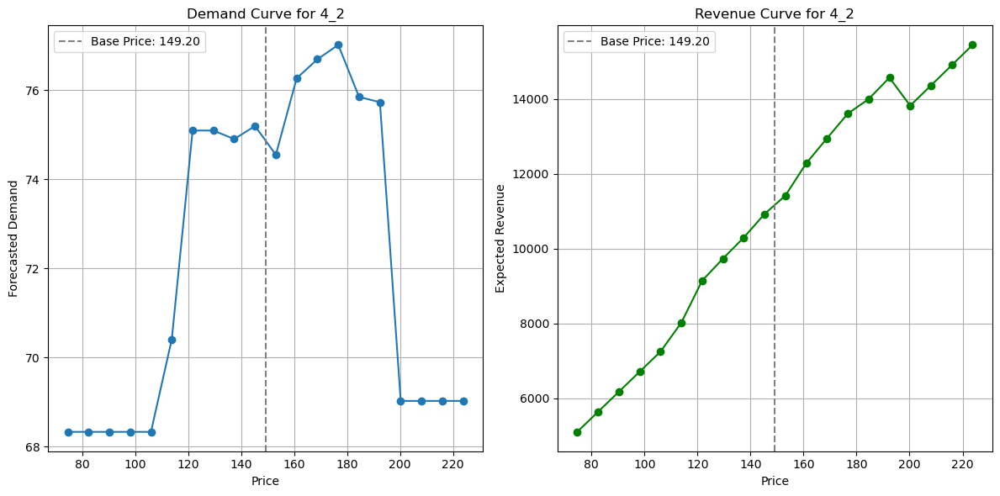

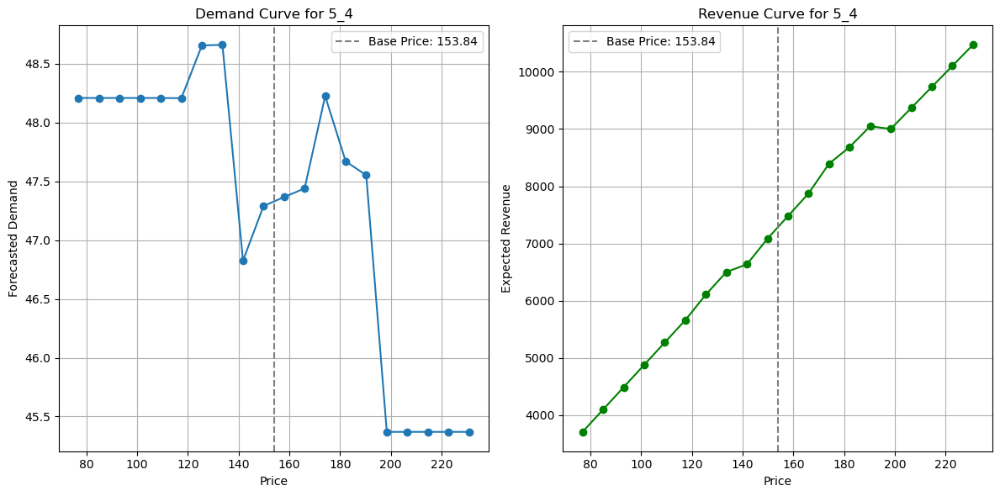

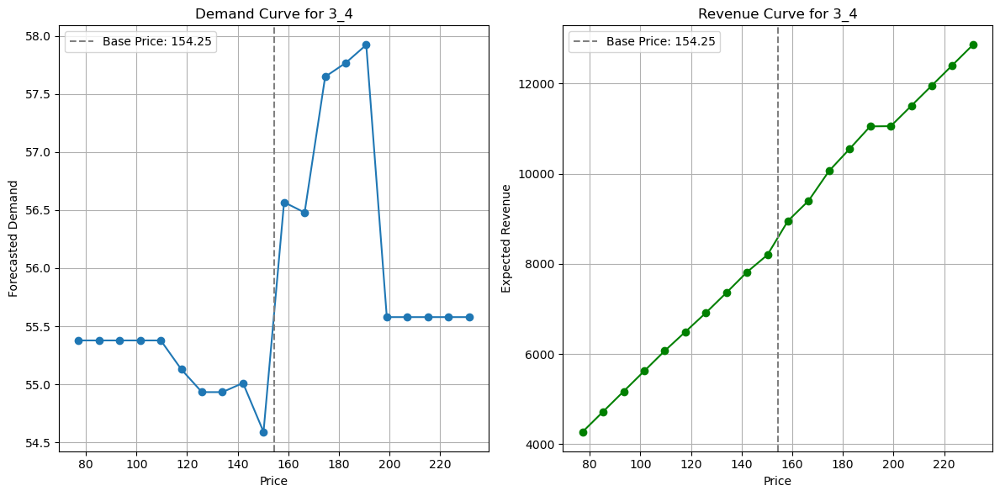

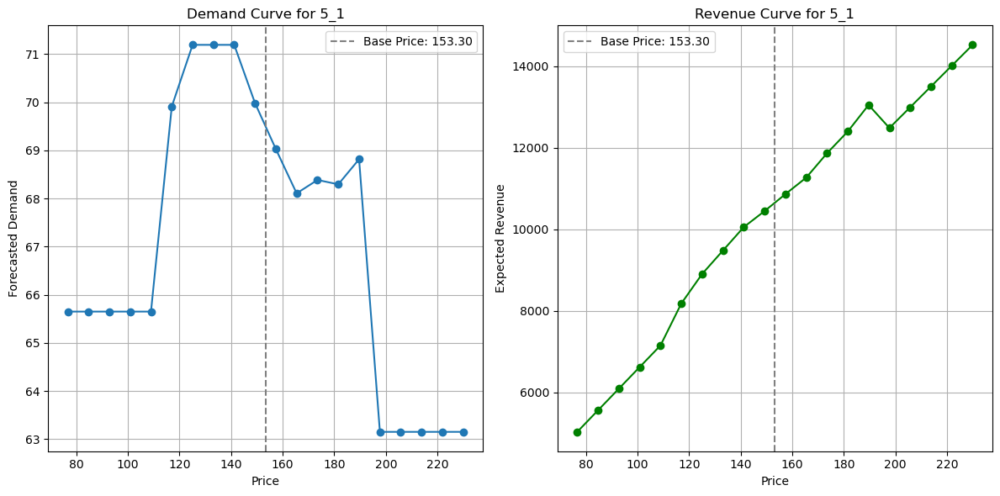

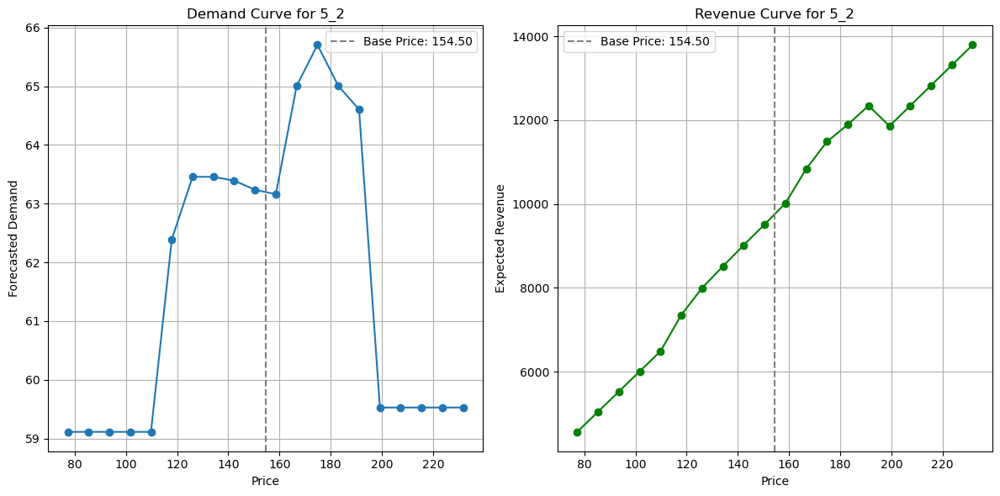

...

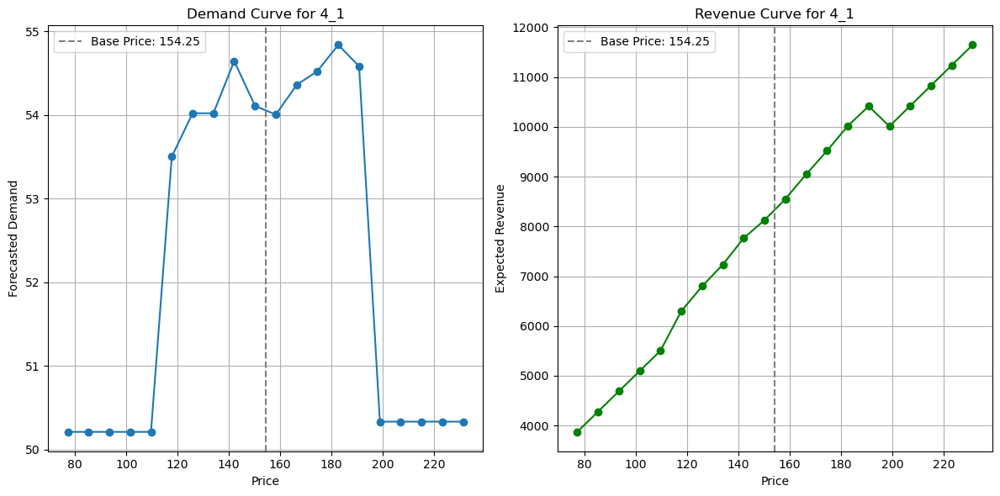

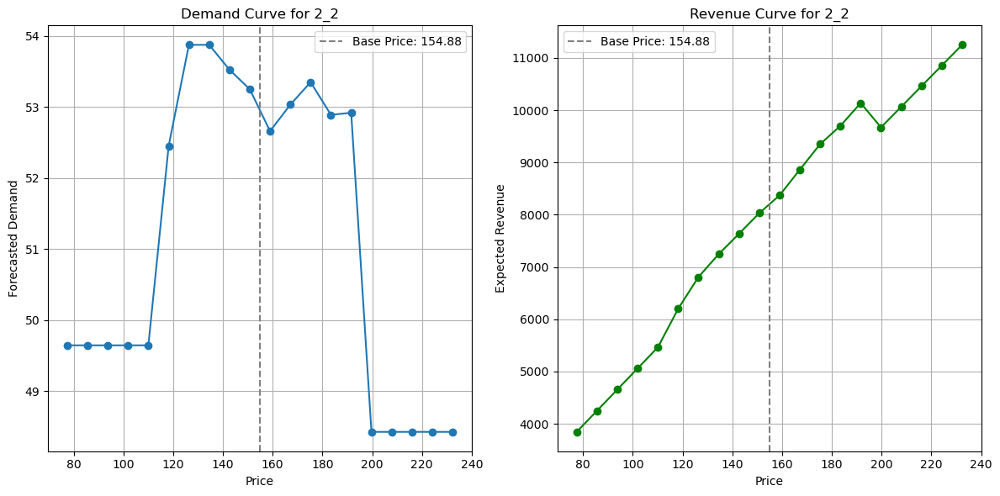

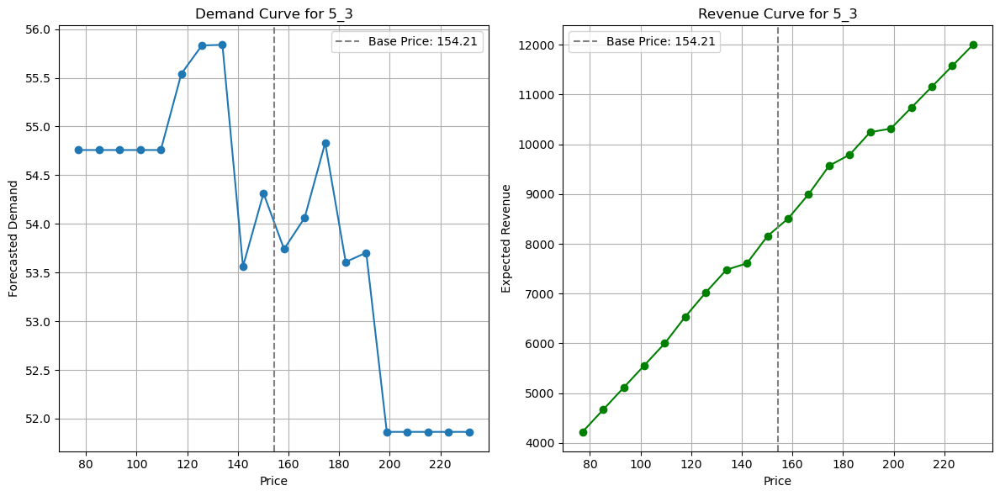

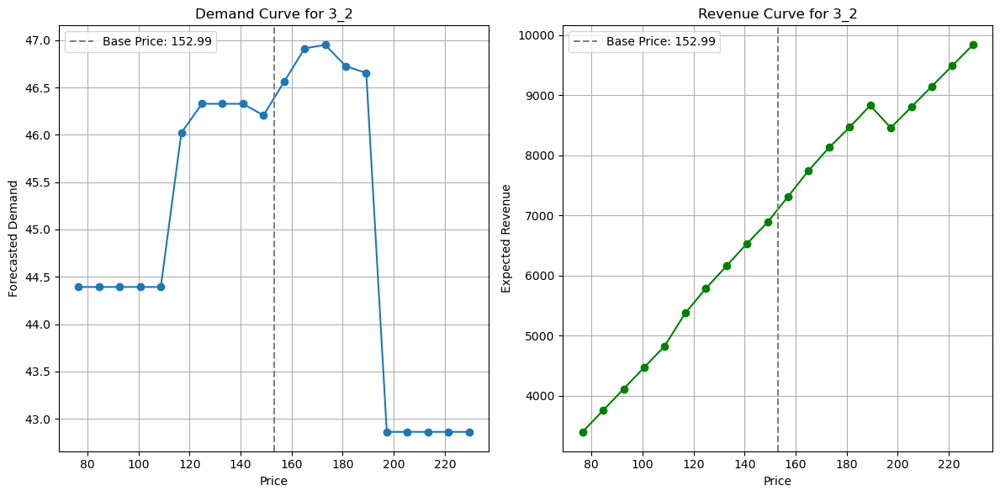

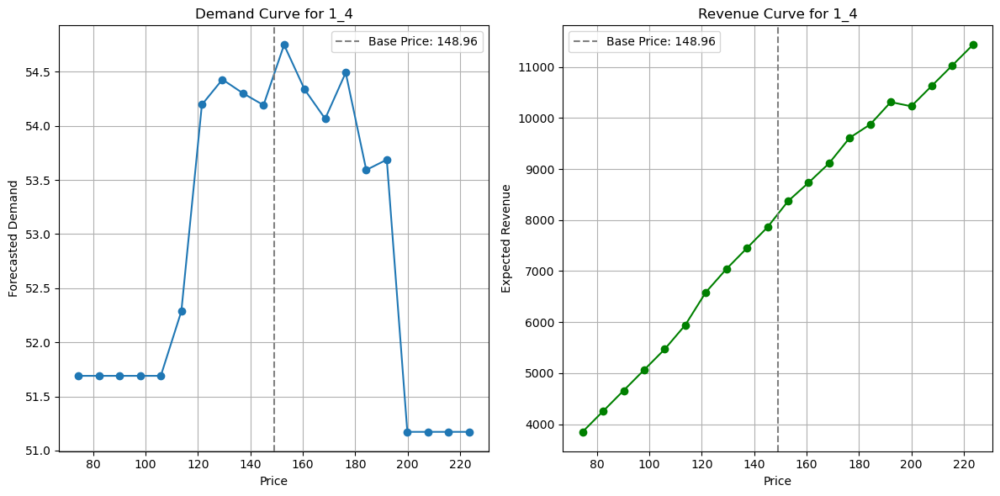

In [5]:
# We need to check wheter or not the demand curves makes sense;

for subcat_id in forecaster.df_panel['subcategory_identifier'].unique():
    price_optimisation.plot_demand_curve(forecaster, 'subcategory_identifier', subcat_id, base_prices[subcat_id], pct_range=0.5)

In [6]:
# Run simulation and optimisation
optimal_prices_df = price_optimisation.run_end_to_end_optimisation(
    forecaster,
    base_prices,
    forecaster.df_panel,
    pct_range=0.5,
    steps=20,
    group_key='subcategory_identifier'
)



Simulating demand: 100%|██████████| 20/20 [00:00<00:00, 172.41it/s]

Restricted license - for non-production use only - expires 2026-11-23
Set parameter TimeLimit to value 60
Set parameter MIPGap to value 0.01
Set parameter Threads to value 4
Gurobi Optimizer version 12.0.2 build v12.0.2rc0 (win64 - Windows 11.0 (26100.2))

CPU model: Intel(R) Core(TM) i7-14700F, instruction set [SSE2|AVX|AVX2]
Thread count: 20 physical cores, 28 logical processors, using up to 4 threads

Non-default parameters:
TimeLimit  60
MIPGap  0.01
Threads  4

Optimize a model with 20 rows, 400 columns and 400 nonzeros
Model fingerprint: 0xe11df1cd
Variable types: 0 continuous, 400 integer (400 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [3e+03, 2e+04]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 1e+00]
Found heuristic solution: objective 89456.178555
Presolve removed 20 rows and 400 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.01 seconds (0.00 work units)

In [7]:
optimal_prices_df

,subcategory_identifier,optimal_price
0,1_1,228.067500
1,4_4,230.084032
2,4_2,223.802308
3,3_1,228.366600
4,5_1,229.953429
5,1_3,232.866875
6,4_3,224.591667
7,2_1,229.444286
8,5_2,231.756429
9,2_3,227.823750


In [8]:
# lets then evaluate the price optimsation per product per dayl;

# Load previously saved forecaster object 
forecaster = load_forecaster(constants.MODEL_DIR / "product_by_day_demand_forecaster.pkl")

In [9]:
base_prices = (
    forecaster.df_panel
    .groupby('product_id')['price']
    .median()
    .to_dict()
)

In a two-stage intermittent demand model, we estimate demand using:

Forecasted Quantity
= 𝑃(Sale Occurs)×𝐸[Quantity∣Sale] Forecasted Quantity=P(Sale Occurs)×E[Quantity∣Sale]

However, for many products especially in long-tail categories or on a daily granularity the probability of a sale occurring is often very low. This results in near-zero forecasts, even when the expected quantity (if sold) is reasonable. To address this we apply a minimnum probability threhold. If the classification model predicts 

P(Sale) < 0.5 we clip it to 0.5 

This represents a base belif that the product has a 50% chance of being purchased under the simulated conditions. 

This can be adjusted dynamically based on product category/Seasonality/Historical Frequency or other domain specific knowledge
 
We can even extend it dynamically by implementing a rule-based probability function.



c:\Users\jyuey\OneDrive\Documents\Python_Scripts\temple_and_webster_case_study\src\models\price_optimisation.py:292: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  plt.figure(figsize=(12, 6))


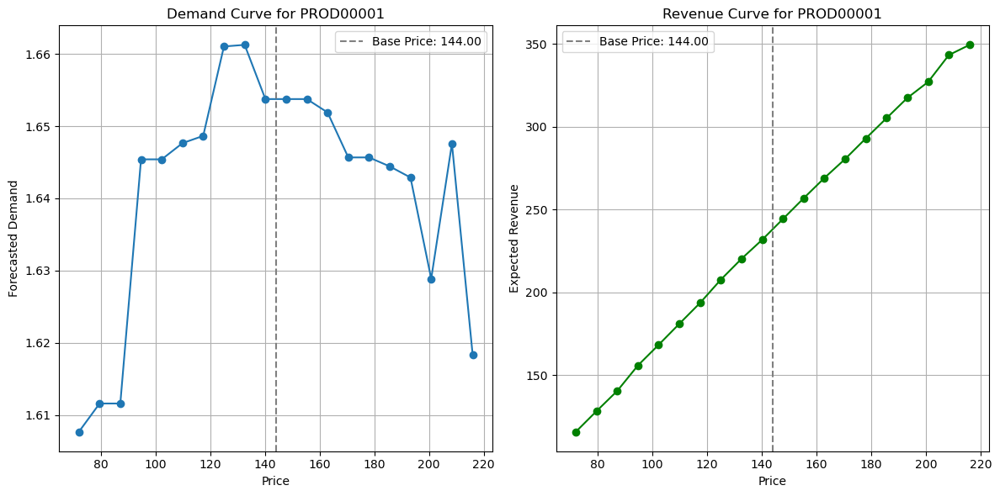

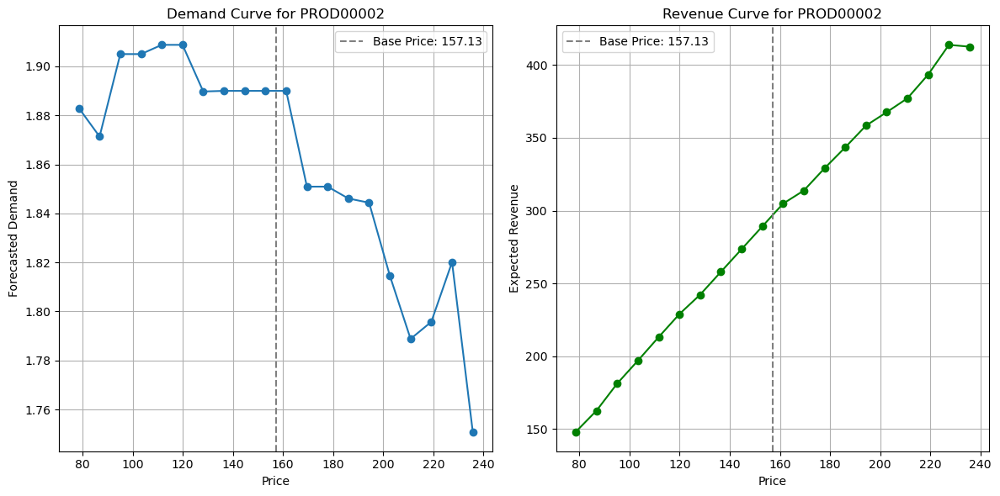

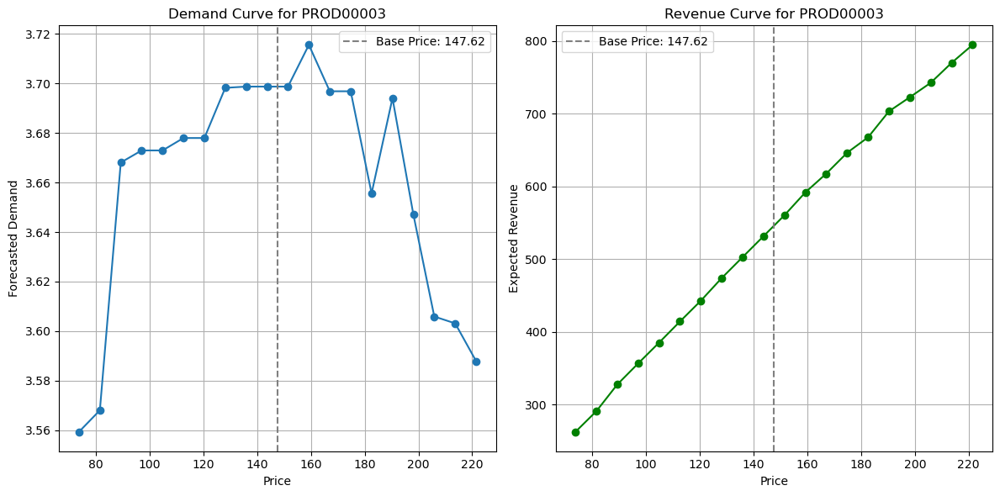

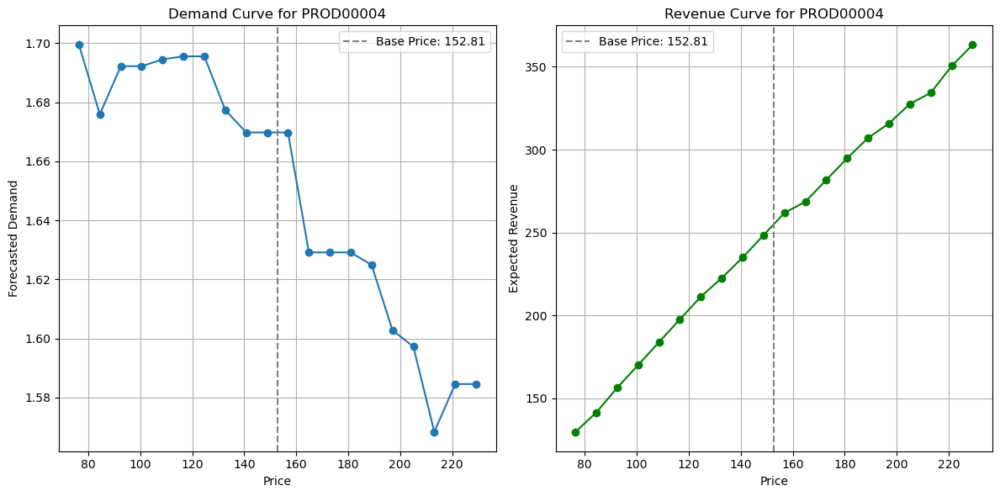

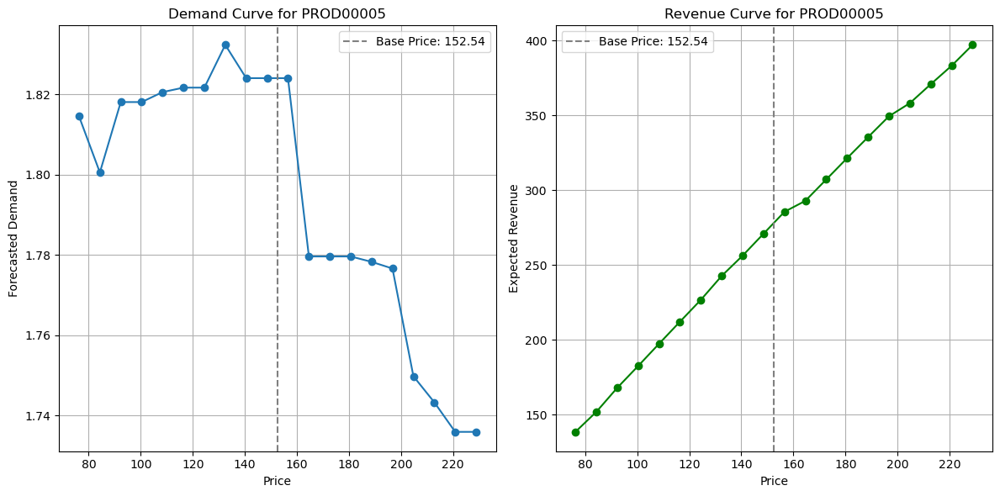

...

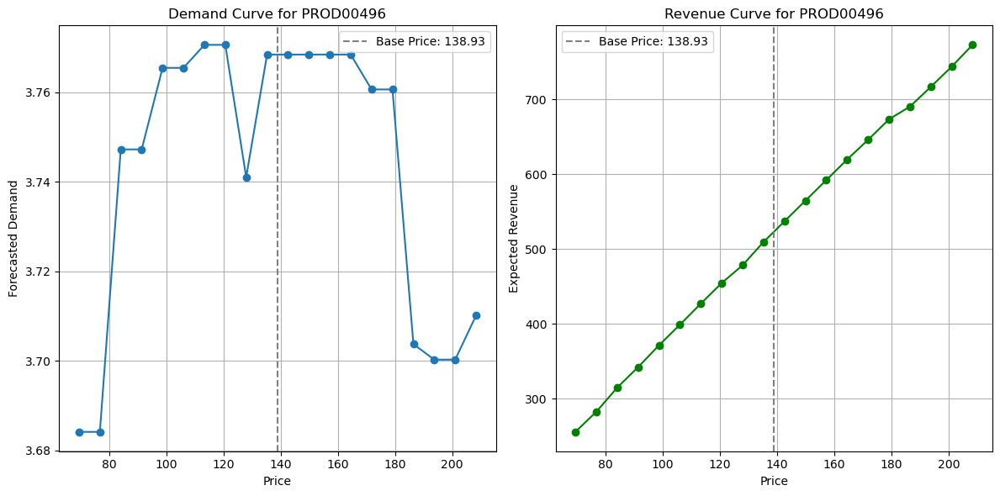

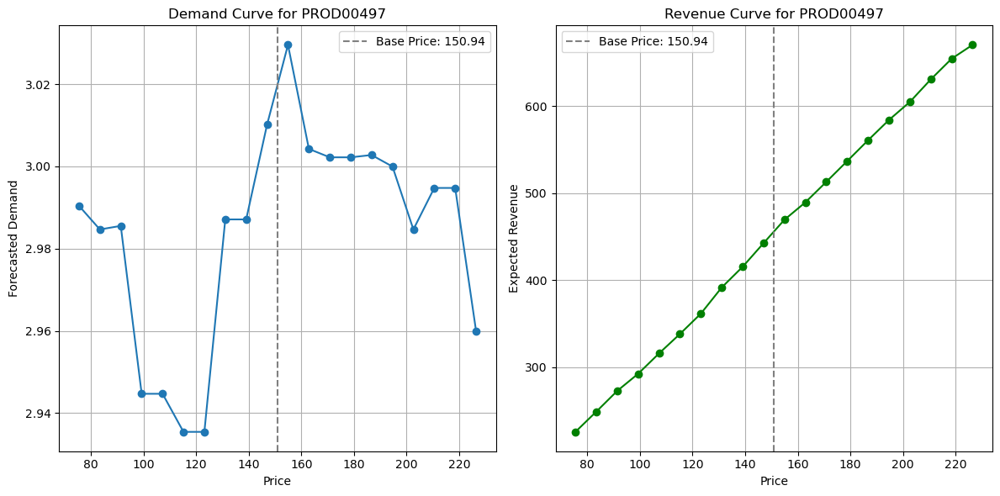

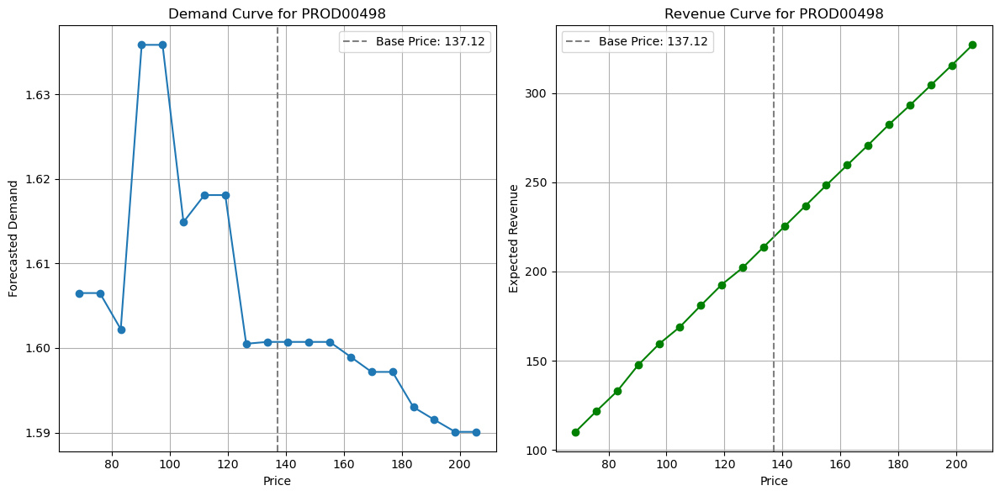

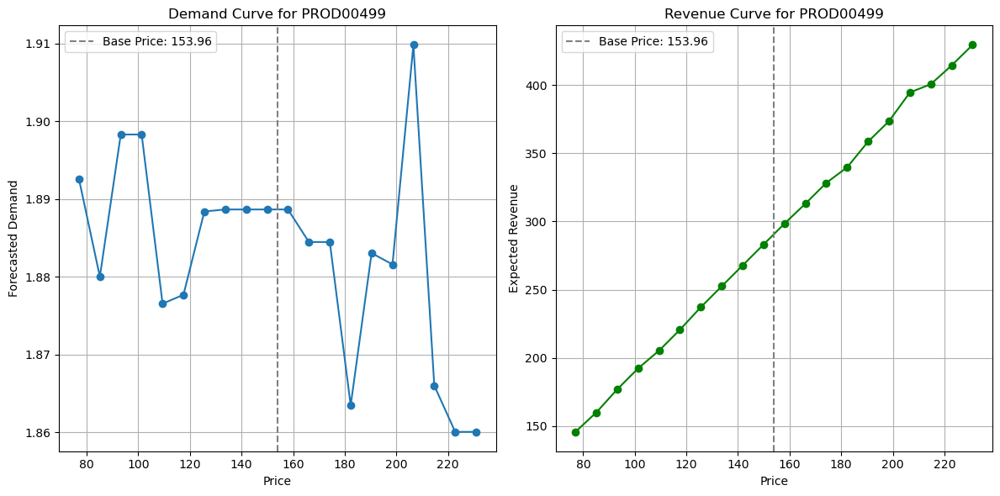

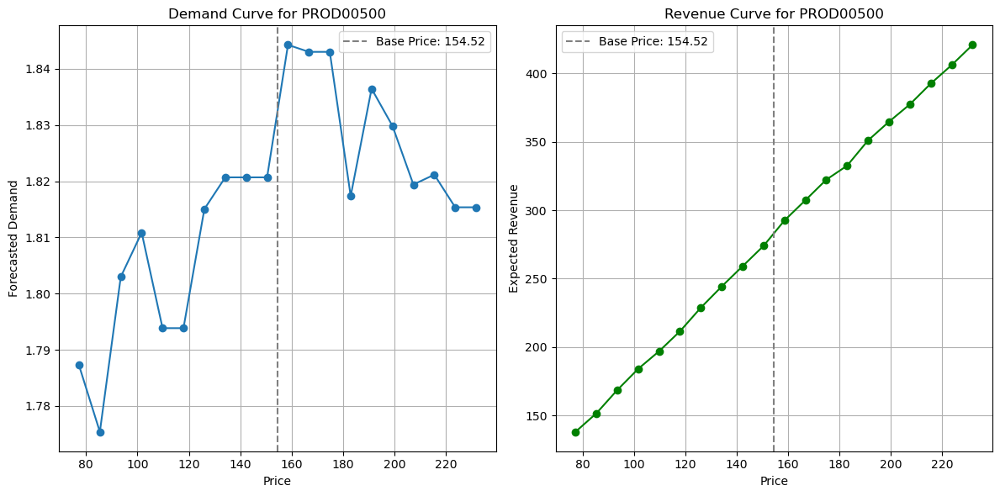

In [10]:

for product_id in forecaster.df_panel['product_id'].unique():
    price_optimisation.plot_demand_curve(forecaster, 'product_id', product_id, base_prices[product_id], pct_range=0.5, clip=True, min_clip_prob=0.5, save_path= constants.PLOT_DIR / f'demand_curve_{product_id}.png')

In [11]:
# Run simulation and optimisation
optimal_prices_df = price_optimisation.run_end_to_end_optimisation(
    forecaster,
    base_prices,
    forecaster.df_panel,
    pct_range=0.3,
    steps=5,
    group_key='product_id'
)


Simulating demand: 100%|██████████| 500/500 [00:11<00:00, 42.39it/s]


Set parameter TimeLimit to value 60
Set parameter MIPGap to value 0.01
Set parameter Threads to value 4
Gurobi Optimizer version 12.0.2 build v12.0.2rc0 (win64 - Windows 11.0 (26100.2))

CPU model: Intel(R) Core(TM) i7-14700F, instruction set [SSE2|AVX|AVX2]
Thread count: 20 physical cores, 28 logical processors, using up to 4 threads

Non-default parameters:
TimeLimit  60
MIPGap  0.01
Threads  4

Optimize a model with 50 rows, 250 columns and 250 nonzeros
Model fingerprint: 0x9132c66c
Variable types: 0 continuous, 250 integer (250 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [3e+02, 8e+02]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 1e+00]
Found heuristic solution: objective 19184.448021
Presolve removed 50 rows and 250 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.00 seconds (0.00 work units)
Thread count was 1 (of 28 available processors)

Solution count 2: 35

In [14]:
mask = optimal_prices_df['product_id'].isin(["PROD00463", "PROD00238", "PROD00177", "PROD00365"])

In [15]:
optimal_prices_df[mask]

,product_id,optimal_price
44,PROD00177,200.933866
166,PROD00238,222.333546
473,PROD00463,184.119481
482,PROD00365,197.082473
